# Audio Fingerprinting for Music Content Identification

In this tutorial, we will delve into how music content identification is done through the audio fingerprinting method.

We will use open source code from the [Dejavu](https://github.com/worldveil/dejavu) project (credits to Will Drevo [@worldveil]()!) to showcase the audio fingerprinting and matching process, and test the robustness of the fingerprints towards audio distortion such as noise and pitch shift.

## Preparation

### Install Dependencies

In [ ]:
!pip install pydub
!pip install tabulate

### Config constants

In [ ]:
# FINGERPRINTS CONFIG:
# This is used as connectivity parameter for scipy.generate_binary_structure function. This parameter
# changes the morphology mask when looking for maximum peaks on the spectrogram matrix.
# Possible values are: [1, 2]
# Where 1 sets a diamond morphology which implies that diagonal elements are not considered as neighbors (this
# is the value used in the original dejavu code).
# And 2 sets a square mask, i.e. all elements are considered neighbors.
CONNECTIVITY_MASK = 2

# Sampling rate, related to the Nyquist conditions, which affects
# the range frequencies we can detect.
DEFAULT_FS = 44100

# Size of the FFT window, affects frequency granularity
DEFAULT_WINDOW_SIZE = 4096

# Ratio by which each sequential window overlaps the last and the
# next window. Higher overlap will allow a higher granularity of offset
# matching, but potentially more fingerprints.
DEFAULT_OVERLAP_RATIO = 0.5

# Degree to which a fingerprint can be paired with its neighbors. Higher values will
# cause more fingerprints, but potentially better accuracy.
DEFAULT_FAN_VALUE = 15  # 15 was the original value.

# Minimum amplitude in spectrogram in order to be considered a peak.
# This can be raised to reduce number of fingerprints, but can negatively
# affect accuracy.
DEFAULT_AMP_MIN = 10

# Number of cells around an amplitude peak in the spectrogram in order
# for Dejavu to consider it a spectral peak. Higher values mean less
# fingerprints and faster matching, but can potentially affect accuracy.
PEAK_NEIGHBORHOOD_SIZE = 10  # 20 was the original value.

# Thresholds on how close or far fingerprints can be in time in order
# to be paired as a fingerprint. If your max is too low, higher values of
# DEFAULT_FAN_VALUE may not perform as expected.
MIN_HASH_TIME_DELTA = 0
MAX_HASH_TIME_DELTA = 200

# If True, will sort peaks temporally for fingerprinting;
# not sorting will cut down number of fingerprints, but potentially
# affect performance.
PEAK_SORT = True

# Number of bits to grab from the front of the SHA1 hash in the
# fingerprint calculation. The more you grab, the more memory storage,
# with potentially lesser collisions of matches.
FINGERPRINT_REDUCTION = 20

# Number of results being returned for file recognition
TOPN = 2

### Utilities

In [ ]:
import fnmatch
import os
from hashlib import sha1
from typing import List, Tuple

import numpy as np
from pydub import AudioSegment
from pydub.utils import audioop


def unique_hash(file_path: str, block_size: int = 2**20) -> str:
    """ Small function to generate a hash to uniquely generate
    a file. Inspired by MD5 version here:
    http://stackoverflow.com/a/1131255/712997

    Works with large files.

    :param file_path: path to file.
    :param block_size: read block size.
    :return: a hash in an hexagesimal string form.
    """
    s = sha1()
    with open(file_path, "rb") as f:
        while True:
            buf = f.read(block_size)
            if not buf:
                break
            s.update(buf)
    return s.hexdigest().upper()


def find_files(path: str, extensions: List[str]) -> List[Tuple[str, str]]:
    """
    Get all files that meet the specified extensions.

    :param path: path to a directory with audio files.
    :param extensions: file extensions to look for.
    :return: a list of tuples with file name and its extension.
    """
    # Allow both with ".mp3" and without "mp3" to be used for extensions
    extensions = [e.replace(".", "") for e in extensions]

    results = []
    for dirpath, dirnames, files in os.walk(path):
        for extension in extensions:
            for f in fnmatch.filter(files, f"*.{extension}"):
                p = os.path.join(dirpath, f)
                results.append((p, extension))
    return results


def read(file_name: str, limit: int = None) -> Tuple[List[List[int]], int, str]:
    """
    Reads any file supported by pydub (ffmpeg) and returns the data contained
    within. If file reading fails due to input being a 24-bit wav file,
    wavio is used as a backup.

    Can be optionally limited to a certain amount of seconds from the start
    of the file by specifying the `limit` parameter. This is the amount of
    seconds from the start of the file.

    :param file_name: file to be read.
    :param limit: number of seconds to limit.
    :return: tuple list of (channels, sample_rate, content_file_hash).
    """
    # pydub does not support 24-bit wav files, use wavio when this occurs
    try:
        audiofile = AudioSegment.from_file(file_name)

        if limit:
            audiofile = audiofile[:limit * 1000]

        data = np.fromstring(audiofile.raw_data, np.int16)

        channels = []
        for chn in range(audiofile.channels):
            channels.append(data[chn::audiofile.channels])

        audiofile.frame_rate
    except audioop.error:
        print("Audio load error")
        return

    return channels, audiofile.frame_rate, unique_hash(file_name)


def get_audio_name_from_path(file_path: str) -> str:
    """
    Extracts song name from a file path.

    :param file_path: path to an audio file.
    :return: file name
    """
    return os.path.splitext(os.path.basename(file_path))[0]

In [ ]:
import abc
from time import time
from typing import Dict, List, Tuple

import numpy as np
import hashlib
from operator import itemgetter
from typing import List, Tuple
from itertools import groupby

import matplotlib.mlab as mlab
import matplotlib.pyplot as plt
from scipy.ndimage.filters import maximum_filter
from scipy.ndimage.morphology import (binary_erosion,
                                      generate_binary_structure,
                                      iterate_structure)

<ipython-input-10-d8a357745e61>:13: DeprecationWarning: Please import `maximum_filter` from the `scipy.ndimage` namespace; the `scipy.ndimage.filters` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.filters import maximum_filter
<ipython-input-10-d8a357745e61>:14: DeprecationWarning: Please import `binary_erosion` from the `scipy.ndimage` namespace; the `scipy.ndimage.morphology` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.morphology import (binary_erosion,
<ipython-input-10-d8a357745e61>:14: DeprecationWarning: Please import `generate_binary_structure` from the `scipy.ndimage` namespace; the `scipy.ndimage.morphology` namespace is deprecated and will be removed in SciPy 2.0.0.
  from scipy.ndimage.morphology import (binary_erosion,
<ipython-input-10-d8a357745e61>:14: DeprecationWarning: Please import `iterate_structure` from the `scipy.ndimage` namespace; the `scipy.ndimage.morphology` namespace is deprecated and wi

### Fingerprinting / Matching Functions

In [ ]:
def fingerprint(channel_samples: List[int],
                Fs: int = DEFAULT_FS,
                wsize: int = DEFAULT_WINDOW_SIZE,
                wratio: float = DEFAULT_OVERLAP_RATIO,
                fan_value: int = DEFAULT_FAN_VALUE,
                amp_min: int = DEFAULT_AMP_MIN,
                plot: bool = False) -> List[Tuple[str, int]]:
    """
    FFT the channel, log transform output, find local maxima, then return locally sensitive hashes.

    :param channel_samples: channel samples to fingerprint.
    :param Fs: audio sampling rate.
    :param wsize: FFT windows size.
    :param wratio: ratio by which each sequential window overlaps the last and the next window.
    :param fan_value: degree to which a fingerprint can be paired with its neighbors.
    :param amp_min: minimum amplitude in spectrogram in order to be considered a peak.
    :return: a list of hashes with their corresponding offsets.
    """
    # FFT the signal and extract frequency components
    arr2D = mlab.specgram(
        channel_samples,
        NFFT=wsize,
        Fs=Fs,
        window=mlab.window_hanning,
        noverlap=int(wsize * wratio))[0]

    # Apply log transform since specgram function returns linear array. 0s are excluded to avoid np warning.
    arr2D = 10 * np.log10(arr2D, out=np.zeros_like(arr2D), where=(arr2D != 0))

    local_maxima = get_2D_peaks(arr2D, plot=plot, amp_min=amp_min)
    if plot:
      print("Number of peaks:", len(local_maxima))
      print("Peaks:", local_maxima[:10], "...")

    # return hashes
    return generate_hashes(local_maxima, fan_value=fan_value, plot=plot)


def get_2D_peaks(arr2D: np.array, plot: bool = True, amp_min: int = DEFAULT_AMP_MIN)\
        -> List[Tuple[List[int], List[int]]]:
    """
    Extract maximum peaks from the spectogram matrix (arr2D).

    :param arr2D: matrix representing the spectogram.
    :param plot: for plotting the results.
    :param amp_min: minimum amplitude in spectrogram in order to be considered a peak.
    :return: a list composed by a list of frequencies and times.
    """
    # Original code from the repo is using a morphology mask that does not consider diagonal elements
    # as neighbors (basically a diamond figure) and then applies a dilation over it, so what I'm proposing
    # is to change from the current diamond figure to a just a normal square one:
    #       F   T   F           T   T   T
    #       T   T   T   ==>     T   T   T
    #       F   T   F           T   T   T
    # In my local tests time performance of the square mask was ~3 times faster
    # respect to the diamond one, without hurting accuracy of the predictions.
    # I've made now the mask shape configurable in order to allow both ways of find maximum peaks.
    # That being said, we generate the mask by using the following function
    # https://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.generate_binary_structure.html
    struct = generate_binary_structure(2, CONNECTIVITY_MASK)

    #  And then we apply dilation using the following function
    #  http://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.iterate_structure.html
    #  Take into account that if PEAK_NEIGHBORHOOD_SIZE is 2 you can avoid the use of the scipy functions and just
    #  change it by the following code:
    #  neighborhood = np.ones((PEAK_NEIGHBORHOOD_SIZE * 2 + 1, PEAK_NEIGHBORHOOD_SIZE * 2 + 1), dtype=bool)
    neighborhood = iterate_structure(struct, PEAK_NEIGHBORHOOD_SIZE)

    # find local maxima using our filter mask
    local_max = maximum_filter(arr2D, footprint=neighborhood) == arr2D

    # Applying erosion, the dejavu documentation does not talk about this step.
    background = (arr2D == 0)
    eroded_background = binary_erosion(background, structure=neighborhood, border_value=1)

    # Boolean mask of arr2D with True at peaks (applying XOR on both matrices).
    detected_peaks = local_max != eroded_background

    # extract peaks
    amps = arr2D[detected_peaks]
    freqs, times = np.where(detected_peaks)

    # filter peaks
    amps = amps.flatten()

    # get indices for frequency and time
    filter_idxs = np.where(amps > amp_min)

    freqs_filter = freqs[filter_idxs]
    times_filter = times[filter_idxs]

    if plot:
        # scatter of the peaks
        fig, ax = plt.subplots()
        ax.imshow(arr2D, cmap="jet")
        ax.set_xlabel('Time')
        ax.set_ylabel('Frequency')
        ax.set_title("Spectrogram")
        plt.gca().invert_yaxis()
        plt.show()

        fig, ax = plt.subplots()
        ax.imshow(arr2D, cmap="jet")
        ax.scatter(times_filter, freqs_filter, s=0.1)
        ax.set_xlabel('Time')
        ax.set_ylabel('Frequency')
        ax.set_title("Spectrogram with peaks")
        plt.gca().invert_yaxis()
        plt.show()

    return list(zip(freqs_filter, times_filter))


def generate_hashes(peaks: List[Tuple[int, int]], fan_value: int = DEFAULT_FAN_VALUE, plot=False) -> List[Tuple[str, int]]:
    """
    Hash list structure:
       sha1_hash[0:FINGERPRINT_REDUCTION]    time_offset
        [(e05b341a9b77a51fd26, 32), ... ]

    :param peaks: list of peak frequencies and times.
    :param fan_value: degree to which a fingerprint can be paired with its neighbors.
    :return: a list of hashes with their corresponding offsets.
    """
    # frequencies are in the first position of the tuples
    idx_freq = 0
    # times are in the second position of the tuples
    idx_time = 1

    if PEAK_SORT:
        peaks.sort(key=itemgetter(1))

    hashes = []

    # NAIVE HASH
    for i in range(len(peaks)):
        t, f = peaks[i]
        h = hashlib.sha1(f"{str(f)}".encode('utf-8'))
        hashes.append((h.hexdigest()[0:FINGERPRINT_REDUCTION], t))

        if plot and i == 0:
            print(f"Calculating hash for {peaks[i]}")
            print(f"Computed hash: (hash, offset) = (sha({str(f)}), {t}) = ({h.hexdigest()[0:FINGERPRINT_REDUCTION]}, {t})")

    if plot:
      print("Number of fingerprints:", len(hashes))

    return hashes


def generate_fingerprints(samples: List[int], Fs=DEFAULT_FS, plot=False) -> Tuple[List[Tuple[str, int]], float]:
        f"""
        Generate the fingerprints for the given sample data (channel).

        :param samples: list of ints which represents the channel info of the given audio file.
        :param Fs: sampling rate which defaults to {DEFAULT_FS}.
        :return: a list of tuples for hash and its corresponding offset, together with the generation time.
        """
        t = time()
        hashes = fingerprint(samples, Fs=Fs, plot=plot)
        fingerprint_time = time() - t
        return hashes, fingerprint_time


def get_hashes(data, plot=False) -> Tuple[List[Dict[str, any]], int, int, int]:
        fingerprint_times = []
        hashes = set()  # to remove possible duplicated fingerprints we built a set.
        for idx, channel in enumerate(data):
            if idx % 2 == 0:
              plot1 = True and plot
            else:
              plot1 = False and plot
            fingerprints, fingerprint_time = generate_fingerprints(channel, Fs=Fs, plot=plot1)
            fingerprint_times.append(fingerprint_time)
            hashes |= set(fingerprints)

        return hashes

In [ ]:
def match_hashes(hashes, hashes_db):
        mapper = {}
        for hsh, offset in hashes:
            if hsh.upper() in mapper.keys():
                mapper[hsh.upper()].append(offset)
            else:
                mapper[hsh.upper()] = [offset]

        values = list(mapper.keys())

        # in order to count each hash only once per db offset we use the dic below
        dedup_hashes = {}

        results = []
        for sid, hash_db in enumerate(hashes_db):
            for hsh, offset in hash_db:
                if hsh.upper() in mapper:
                  if sid not in dedup_hashes.keys():
                      dedup_hashes[sid] = 1
                  else:
                      dedup_hashes[sid] += 1
                  #  we now evaluate all offset for each  hash matched
                  for song_sampled_offset in mapper[hsh.upper()]:
                      # it is only reasonable that offset > song_sampled_offset in order for the query to be "part of" the song
                      if offset - song_sampled_offset > 0:
                        results.append((sid, offset - song_sampled_offset))

        return results, dedup_hashes


def align_matches(matches: List[Tuple[int, int]], dedup_hashes: Dict[str, int], queried_hashes: int,
                      db_hashes: List[int], songnames: List[str], topn: int = 2) -> List[Dict[str, any]]:
        """
        Finds hash matches that align in time with other matches and finds
        consensus about which hashes are "true" signal from the audio.

        :param matches: matches from the database
        :param dedup_hashes: dictionary containing the hashes matched without duplicates for each song
        (key is the song id).
        :param queried_hashes: amount of hashes sent for matching against the db
        :param topn: number of results being returned back.
        :return: a list of dictionaries (based on topn) with match information.
        """
        # count offset occurrences per song and keep only the maximum ones.
        sorted_matches = sorted(matches, key=lambda m: (m[0], m[1]))
        counts = [(*key, len(list(group))) for key, group in groupby(sorted_matches, key=lambda m: (m[0], m[1]))]
        songs_matches = sorted(
            [max(list(group), key=lambda g: g[2]) for key, group in groupby(counts, key=lambda count: count[0])],
            key=lambda count: count[2], reverse=True
        )

        songs_result = []
        scores = []
        for song_id, offset, _ in songs_matches:

            song_hashes = db_hashes[song_id]
            nseconds = round(float(offset) / DEFAULT_FS * DEFAULT_WINDOW_SIZE * DEFAULT_OVERLAP_RATIO, 5)
            hashes_matched = dedup_hashes[song_id]
            scores.append((song_id, round(hashes_matched / queried_hashes, 2), nseconds))

        scores.sort(key = lambda x: x[1], reverse=True)

        from tabulate import tabulate

        # assign data
        mydata = [[songnames[elem[0]], elem[1], elem[2]] for elem in scores]

        # create header
        head = ["Song", "Score", "Offset (secs)"]

        # display table
        print(tabulate(mydata, headers=head, tablefmt="grid"))

## Naive Fingerprinting

First, let's get a sense of how the "fingerprints" look like.

Fingerprints are essentially hashes computed using the "peaks" on an audio spectrogram. Let's visualize the "peaks" and the computed hashes.

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


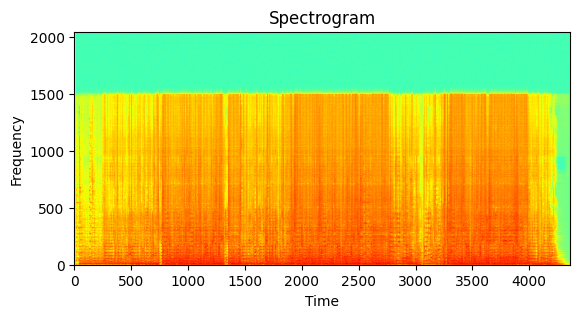

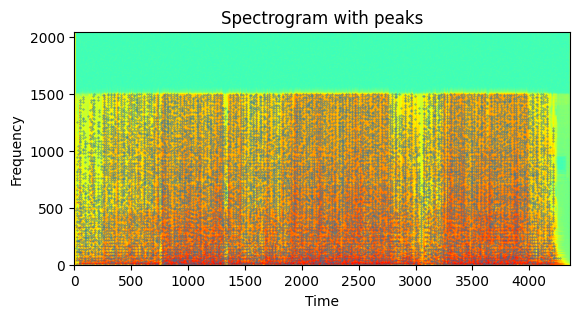

Number of peaks: 12840
Peaks: [(4, 1062), (5, 18), (5, 604), (5, 692), (5, 714), (5, 728), (5, 924), (5, 974), (5, 1098), (5, 1207)] ...
Calculating hash for (146, 16)
Computed hash: (hash, offset) = (sha(16), 146) = (1574bddb75c78a6fd225, 146)
Number of fingerprints: 12840


In [ ]:
channels, Fs, _ = read("sample_data/Taylor Swift - Our Song.mp3")
hashes1 = get_hashes(channels, plot=True)

Here we use a very naive hash method, just hash the frequency and store the time offset. For matching, we are essentially matching the "peaks" of the original and the query. Does it work? Let's see.

Below let's compute the fingerprints of 3 originals, and also compute the fingerprint of a query song. Let's see if we can match the query song to the correct original.

In [ ]:
# compute db fingerprints
channels, Fs, _ = read("sample_data/Taylor Swift - Our Song.mp3")
hashes1 = get_hashes(channels, plot=False)
channels, Fs, _ = read("sample_data/Sam Smith - I'm Not The Only One.mp3")
hashes2 = get_hashes(channels, plot=False)
channels, Fs, _ = read("sample_data/Ed Sheeran - Shape Of You.mp3")
hashes3 = get_hashes(channels, plot=False)
hashes_db = [hashes1, hashes2, hashes3]
songname_db = ["Taylor Swift - Our Song", "Sam Smith - I'm Not The Only One", "Ed Sheeran - Shape Of You"]

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)
<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)
<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# show query song
import IPython.display as ipd
ipd.display(ipd.Audio("sample_data/sam_smith_10s.mp3"))

In [ ]:
# compute query fingerprints
channels, Fs, _ = read("sample_data/sam_smith_10s.mp3")
hashes_query = get_hashes(channels, plot=False)

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# fingerprint matching
results, dedup_hashes = match_hashes(hashes_query, hashes_db)
align_matches(results, dedup_hashes, len(hashes_query), [len(k) for k in hashes_db], songname_db, topn=len(hashes_db))

+----------------------------------+---------+-----------------+
| Song                             |   Score |   Offset (secs) |
+==================================+=========+=================+
| Sam Smith - I'm Not The Only One |    0.92 |         2.64707 |
+----------------------------------+---------+-----------------+
| Taylor Swift - Our Song          |    0.68 |         3.29723 |
+----------------------------------+---------+-----------------+
| Ed Sheeran - Shape Of You        |    0.37 |         2.87927 |
+----------------------------------+---------+-----------------+


Seems to work? Let's try another song.

In [ ]:
# show query song
import IPython.display as ipd
ipd.display(ipd.Audio("sample_data/our_song_10s.mp3"))

In [ ]:
# fingerprint matching
results, dedup_hashes = match_hashes(hashes_query, hashes_db)
align_matches(results, dedup_hashes, len(hashes_query), [len(k) for k in hashes_db], songname_db, topn=len(hashes_db))

+----------------------------------+---------+-----------------+
| Song                             |   Score |   Offset (secs) |
+==================================+=========+=================+
| Sam Smith - I'm Not The Only One |    0.6  |         8.82358 |
+----------------------------------+---------+-----------------+
| Taylor Swift - Our Song          |    0.58 |         9.61306 |
+----------------------------------+---------+-----------------+
| Ed Sheeran - Shape Of You        |    0.26 |         2.18268 |
+----------------------------------+---------+-----------------+


No! It does not work. This means if we only match "peaks" by itself, there are many songs that have the same "peaks" with other songs.

Also, some songs naturally have more "peaks" because the spectral content is more dynamic, and can easily match with other songs.

## Pairwise Hashing

Let's see what Dejavu does to solve this. Instead of fingerprinting one peak, why not fingerprint a combination of peak, e.g. a pair of peaks?

The idea is, many songs have the same peak, but there will be less songs have the same combination of peaks.

In [ ]:
def generate_hashes(peaks: List[Tuple[int, int]], fan_value: int = DEFAULT_FAN_VALUE, plot=False) -> List[Tuple[str, int]]:
    """
    Hash list structure:
       sha1_hash[0:FINGERPRINT_REDUCTION]    time_offset
        [(e05b341a9b77a51fd26, 32), ... ]

    :param peaks: list of peak frequencies and times.
    :param fan_value: degree to which a fingerprint can be paired with its neighbors.
    :return: a list of hashes with their corresponding offsets.
    """
    # frequencies are in the first position of the tuples
    idx_freq = 0
    # times are in the second position of the tuples
    idx_time = 1

    if PEAK_SORT:
        peaks.sort(key=itemgetter(1))

    hashes = []

    # PAIRWISE HASH
    for i in range(len(peaks)):
        for j in range(1, fan_value):
            if (i + j) < len(peaks):

                freq1 = peaks[i][idx_freq]
                freq2 = peaks[i + j][idx_freq]
                t1 = peaks[i][idx_time]
                t2 = peaks[i + j][idx_time]
                t_delta = t2 - t1

                if MIN_HASH_TIME_DELTA <= t_delta <= MAX_HASH_TIME_DELTA:
                    h = hashlib.sha1(f"{str(freq1)}|{str(freq2)}|{str(t_delta)}".encode('utf-8'))

                    if plot and i == 0 and j == 1:
                        print(f"Calculating hash for {peaks[i]} and {peaks[i + j]}")
                        print(f"Computed hash: (hash, offset) = (sha({str(freq1)}|{str(freq2)}|{str(t_delta)}), {t1}) = ({h.hexdigest()[0:FINGERPRINT_REDUCTION]}, {t1})")

                    hashes.append((h.hexdigest()[0:FINGERPRINT_REDUCTION], t1))
    if plot:
      print("Number of fingerprints:", len(hashes))

    return hashes

With the new hashing method, let's try again.

In [ ]:
# compute db fingerprints
channels, Fs, _ = read("sample_data/Taylor Swift - Our Song.mp3")
hashes1 = get_hashes(channels, plot=False)
channels, Fs, _ = read("sample_data/Sam Smith - I'm Not The Only One.mp3")
hashes2 = get_hashes(channels, plot=False)
channels, Fs, _ = read("sample_data/Ed Sheeran - Shape Of You.mp3")
hashes3 = get_hashes(channels, plot=False)
hashes_db = [hashes1, hashes2, hashes3]
songname_db = ["Taylor Swift - Our Song", "Sam Smith - I'm Not The Only One", "Ed Sheeran - Shape Of You"]

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)
<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)
<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# compute query fingerprints
channels, Fs, _ = read("sample_data/our_song_10s.mp3")
hashes_query = get_hashes(channels, plot=False)

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# fingerprint matching
results, dedup_hashes = match_hashes(hashes_query, hashes_db)
align_matches(results, dedup_hashes, len(hashes_query), [len(k) for k in hashes_db], songname_db, topn=len(hashes_db))

+----------------------------------+---------+-----------------+
| Song                             |   Score |   Offset (secs) |
+==================================+=========+=================+
| Taylor Swift - Our Song          |    0.3  |         79.9695 |
+----------------------------------+---------+-----------------+
| Sam Smith - I'm Not The Only One |    0.09 |         66.5484 |
+----------------------------------+---------+-----------------+
| Ed Sheeran - Shape Of You        |    0.09 |         15.6038 |
+----------------------------------+---------+-----------------+


In [ ]:
# show original song and offset
import IPython.display as ipd
ipd.display(ipd.Audio("sample_data/Taylor Swift - Our Song.mp3"))

In [ ]:
# compute query fingerprints
channels, Fs, _ = read("sample_data/sam_smith_10s.mp3")
hashes_query = get_hashes(channels, plot=False)

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# fingerprint matching
results, dedup_hashes = match_hashes(hashes_query, hashes_db)
align_matches(results, dedup_hashes, len(hashes_query), [len(k) for k in hashes_db], songname_db, topn=len(hashes_db))

+----------------------------------+---------+-----------------+
| Song                             |   Score |   Offset (secs) |
+==================================+=========+=================+
| Sam Smith - I'm Not The Only One |    0.32 |        70.9602  |
+----------------------------------+---------+-----------------+
| Taylor Swift - Our Song          |    0.1  |         2.73995 |
+----------------------------------+---------+-----------------+
| Ed Sheeran - Shape Of You        |    0.09 |       123.437   |
+----------------------------------+---------+-----------------+


In [ ]:
# show original song and offset
import IPython.display as ipd
ipd.display(ipd.Audio("sample_data/Sam Smith - I'm Not The Only One.mp3"))

## Robustness towards noise / pitch shift

### Noise

In [ ]:
import IPython.display as ipd
ipd.display(ipd.Audio("sample_data/sam_smith_10s_noise=0.01.mp3"))

In [ ]:
# noise = 0.01
channels, Fs, _ = read("sample_data/sam_smith_10s_noise=0.01.mp3")
hashes_query = get_hashes(channels, plot=False)

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# fingerprint matching
results, dedup_hashes = match_hashes(hashes_query, hashes_db)
align_matches(results, dedup_hashes, len(hashes_query), [len(k) for k in hashes_db], songname_db, topn=len(hashes_db))

+----------------------------------+---------+-----------------+
| Song                             |   Score |   Offset (secs) |
+==================================+=========+=================+
| Sam Smith - I'm Not The Only One |    0.29 |         70.9602 |
+----------------------------------+---------+-----------------+
| Taylor Swift - Our Song          |    0.1  |        182.091  |
+----------------------------------+---------+-----------------+
| Ed Sheeran - Shape Of You        |    0.09 |        123.437  |
+----------------------------------+---------+-----------------+


In [ ]:
import IPython.display as ipd
ipd.display(ipd.Audio("sample_data/sam_smith_10s_noise=0.1.mp3"))

In [ ]:
# noise = 0.1
channels, Fs, _ = read("sample_data/sam_smith_10s_noise=0.1.mp3")
hashes_query = get_hashes(channels, plot=False)

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# fingerprint matching
results, dedup_hashes = match_hashes(hashes_query, hashes_db)
align_matches(results, dedup_hashes, len(hashes_query), [len(k) for k in hashes_db], songname_db, topn=len(hashes_db))

+----------------------------------+---------+-----------------+
| Song                             |   Score |   Offset (secs) |
+==================================+=========+=================+
| Sam Smith - I'm Not The Only One |    0.17 |         70.9602 |
+----------------------------------+---------+-----------------+
| Taylor Swift - Our Song          |    0.07 |         32.8795 |
+----------------------------------+---------+-----------------+
| Ed Sheeran - Shape Of You        |    0.06 |         43.4678 |
+----------------------------------+---------+-----------------+


### Pitch Shift

In [ ]:
# pitch shift
import IPython.display as ipd
ipd.display(ipd.Audio("sample_data/sam_smith_10s_pitch=1.mp3"))

In [ ]:
# pitch shift
channels, Fs, _ = read("sample_data/sam_smith_10s_pitch=1.mp3")
hashes_query = get_hashes(channels, plot=False)

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# fingerprint matching
results, dedup_hashes = match_hashes(hashes_query, hashes_db)
align_matches(results, dedup_hashes, len(hashes_query), [len(k) for k in hashes_db], songname_db, topn=len(hashes_db))

+----------------------------------+---------+-----------------+
| Song                             |   Score |   Offset (secs) |
+==================================+=========+=================+
| Sam Smith - I'm Not The Only One |    0.08 |         182.184 |
+----------------------------------+---------+-----------------+
| Ed Sheeran - Shape Of You        |    0.08 |         140.62  |
+----------------------------------+---------+-----------------+
| Taylor Swift - Our Song          |    0.08 |         147.075 |
+----------------------------------+---------+-----------------+


### Covers

In [ ]:
# covers
import IPython.display as ipd
ipd.display(ipd.Audio("sample_data/Boyce Avenue - I'm Not The Only One.mp3"))

In [ ]:
# covers
channels, Fs, _ = read("sample_data/Boyce Avenue - I'm Not The Only One.mp3")
hashes_query = get_hashes(channels, plot=False)

<ipython-input-6-4b42ffc364ec>:73: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  data = np.fromstring(audiofile.raw_data, np.int16)


In [ ]:
# fingerprint matching
results, dedup_hashes = match_hashes(hashes_query, hashes_db)
align_matches(results, dedup_hashes, len(hashes_query), [len(k) for k in hashes_db], songname_db, topn=len(hashes_db))

+----------------------------------+---------+-----------------+
| Song                             |   Score |   Offset (secs) |
+==================================+=========+=================+
| Sam Smith - I'm Not The Only One |    0.1  |         16.0682 |
+----------------------------------+---------+-----------------+
| Taylor Swift - Our Song          |    0.09 |         20.062  |
+----------------------------------+---------+-----------------+
| Ed Sheeran - Shape Of You        |    0.09 |         34.3655 |
+----------------------------------+---------+-----------------+
